### This notebook looks at the communicability within and across ntwx with and without SC lesions 

#### The code for communicability, navigation, shortest path are courtesy of Caio Seguin and the Brain Connectivity Toolbox. 
#### They were originally written in Matlab and translated to python by Chat-GPT. 
#### All these functions exist in a script called `communicability_functions.py`
#### See this link for the orginal Matlab versions of the functions (the functions are in the `fcn` folder): https://github.com/brain-networks/local_scfc/tree/main

##### 'structurally isolate' means virtual lesions that make the regions of the a given network (eg: DMN) only have connections to itself.   
##### Essentially, you set the conncetions of the DMN regions/parcels with other ntwx to 0 in the SC mtx.  

##### All of the above will be done as an average for 200 subjects.
##### This NB uses a resolution of 200 Schaefer parcellations.  

In [1]:
# Importage
import warnings
warnings.filterwarnings('ignore')

# os stuff
import os
import sys

import nibabel as nib
from nilearn.plotting import plot_surf, plot_surf_stat_map, plot_roi, plot_anat, plot_surf_roi
from nilearn.image import index_img

import seaborn as sns

# whobpyt stuff
import whobpyt
from whobpyt.data.dataload import dataloader
# from whobpyt.models.jansen_rit import RNNJANSEN
from whobpyt.models.wong_wang import RNNRWW
from whobpyt.datatypes.modelparameters import ParamsModel
from whobpyt.optimization.modelfitting import Model_fitting

# array and pd stuff
import numpy as np
import pandas as pd

# viz stuff
import matplotlib.pyplot as plt

In [2]:
import networkx as nx

In [3]:
import seaborn as sns
import scipy.stats as stats

In [4]:
from collections import Counter

In [5]:
import pickle

In [6]:
from communicability_functions import navigate

In [7]:
parcs = np.arange(0,200,1)

mask = np.tril_indices(len(parcs), -1)

# Labels
_label_file =  '/external/rprshnas01/kcni/hharita/Code/whobpyt/scratch/Schaefer200_7_Ntwx_labels.txt'

f = open(_label_file, "r")
q = f.read()
q = q.rsplit('\n')
# del q[-32:]
labels = q.copy()
labels = np.array(labels)
labels = labels[parcs]


In [8]:
import re

In [9]:
folder_one_path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/Shrey_SS_parcellated_Func_Conns_II'
folder_two_path = SCs_path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/Improved_WWD_HCP_model_runs/All_Subs_SC_Wts/Davide_HCP_Data_Matrix'

# Get the list of files in each folder
folder_one_files = os.listdir(folder_one_path)
folder_two_files = os.listdir(folder_two_path)

# Extract the numbers from the filenames in folder_one
folder_one_numbers = []
for file in folder_one_files:
    match = re.search(r'\d+', file)
    if match:
        folder_one_numbers.append(int(match.group()))

# Extract the numbers from the filenames in folder_two
folder_two_numbers = []
for file in folder_two_files:
    match = re.search(r'\d+', file)
    if match:
        folder_two_numbers.append(int(match.group()))

# Find the common numbers between the two folders
common_numbers = list(set(folder_one_numbers) & set(folder_two_numbers))

sub_list = common_numbers.copy()

sub_list.sort()

sub_list = sub_list[0:200]

In [10]:
Wts_Path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/Improved_WWD_HCP_model_runs/All_Subs_SC_Wts/Davide_HCP_Data_Matrix'

In [11]:
def load_wts(sub_id):

    _df = pd.read_csv(Wts_Path + '/{0}/{0}_new_atlas_Yeo.nii.csv'.format(sub_id), delimiter=' ',header=None)
    df_trimmed = _df.iloc[:-31, :-31]
    np_array = df_trimmed.values
    sc_mtx = np_array + np_array.T # --> Symmetric

    pre_laplachian_HCP_SC = sc_mtx.copy()

    SC = pre_laplachian_HCP_SC.copy()
    sc = np.log1p(SC) / np.linalg.norm(np.log1p(SC))
    
    return pre_laplachian_HCP_SC

In [12]:
%%time
all_subs_pre_lap_SC = []

for i in range(len(sub_list)):
    pre_lap_SC = load_wts(sub_list[i])
    all_subs_pre_lap_SC.append(pre_lap_SC)

CPU times: user 7.23 s, sys: 194 ms, total: 7.42 s
Wall time: 1min 32s


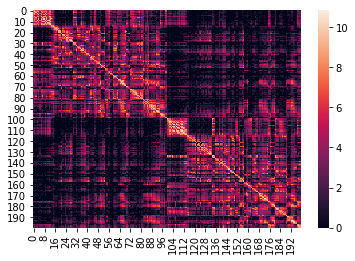

In [13]:
sns.heatmap(np.log1p(all_subs_pre_lap_SC[0]))

In [14]:
pconn_path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/Shrey_SS_parcellated_Func_Conns_II/'

In [15]:
def emp_fc(sub_id):
    pconn1LR = pconn_path + '{0}_rfMRI_REST1_RL_Schaefer200_cifti_parcellated.ptseries.nii'.format(sub_id)
    pconn_img1LR = nib.load(pconn1LR)
    pconn_dat1LR = pconn_img1LR.get_data()
    pconn_dat1LR = pconn_dat1LR/1
    return pconn_dat1LR

In [16]:
%%time

all_subs_emp_fc = []
for i in range(len(sub_list)):
    ss_emp_fc = emp_fc(sub_list[i])
    all_subs_emp_fc.append(ss_emp_fc)

CPU times: user 1min 2s, sys: 925 ms, total: 1min 3s
Wall time: 3min 41s


In [17]:
%%time
all_subs_emp_fc_mat = []
for i in range(200):
    all_subs_emp_fc_mat.append(np.corrcoef(all_subs_emp_fc[i].T))

CPU times: user 1.42 s, sys: 101 ms, total: 1.52 s
Wall time: 1.82 s


In [18]:
og_whobpyt_path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/WhoBPyT/200_subjects_WhoBPyT_run'
lesion_whobpyt_path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/WhoBPyT/Ntwx_Lesion_WhoBPyT_200_subs'

In [19]:
# Subj_164030_vis_lesion_cc_cut_fc_con_mat.txt
# Subj_164030_vis_lesion_fc_con_mat.txt

In [20]:
%%time

all_subs_og_whobpyt = []

all_subs_vis_lesion = []
# all_subs_vis_lesion_cc_cut = []

all_subs_sommot_lesion = []
# all_subs_sommot_lesion_cc_cut = []

all_subs_dorsattn_lesion = []
# all_subs_dorsattn_lesion_cc_cut = []

all_subs_ventattn_lesion = []
# all_subs_ventattn_lesion_cc_cut = []

all_subs_limbic_lesion = []
# all_subs_limbic_lesion_cc_cut = []

all_subs_fpn_lesion = []
# all_subs_fpn_lesion_cc_cut = []

all_subs_dmn_lesion = []
# all_subs_dmn_lesion_cc_cut = []

for i in range(len(sub_list)):
    
    sub_id = sub_list[i]
    
    ss_og_whobpyt = np.loadtxt(og_whobpyt_path + '/{0}_whobypt_fc_mtx.txt'.format(sub_id))
    all_subs_og_whobpyt.append(ss_og_whobpyt)
    
    ss_vis_lesion = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_vis_lesion_fc_con_mat.txt'.format(sub_id))
#     ss_vis_lesion_cc_cut = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_vis_lesion_cc_cut_fc_con_mat.txt'.format(sub_id))
    all_subs_vis_lesion.append(ss_vis_lesion)
#     all_subs_vis_lesion_cc_cut.append(ss_vis_lesion_cc_cut)
    

    ss_sommot_lesion = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_sommot_lesion_fc_con_mat.txt'.format(sub_id))
#     ss_sommot_lesion_cc_cut = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_sommot_lesion_cc_cut_fc_con_mat.txt'.format(sub_id))
    all_subs_sommot_lesion.append(ss_sommot_lesion)
#     all_subs_sommot_lesion_cc_cut.append(ss_sommot_lesion_cc_cut)

    ss_dorsattn_lesion = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_dorsattn_lesion_fc_con_mat.txt'.format(sub_id))
#     ss_dorsattn_lesion_cc_cut = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_dorsattn_lesion_cc_cut_fc_con_mat.txt'.format(sub_id))
    all_subs_dorsattn_lesion.append(ss_dorsattn_lesion)
#     all_subs_dorsattn_lesion_cc_cut.append(ss_dorsattn_lesion_cc_cut)
    

    ss_ventattn_lesion = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_ventattn_lesion_fc_con_mat.txt'.format(sub_id))
#     ss_ventattn_lesion_cc_cut = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_ventattn_lesion_cc_cut_fc_con_mat.txt'.format(sub_id))
    all_subs_ventattn_lesion.append(ss_ventattn_lesion)
#     all_subs_ventattn_lesion_cc_cut.append(ss_ventattn_lesion_cc_cut)

    
    ss_limbic_lesion = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_limbic_lesion_fc_con_mat.txt'.format(sub_id))
#     ss_limbic_lesion_cc_cut = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_limbic_lesion_cc_cut_fc_con_mat.txt'.format(sub_id))
    all_subs_limbic_lesion.append(ss_limbic_lesion)
#     all_subs_limbic_lesion_cc_cut.append(ss_limbic_lesion_cc_cut)

    
    ss_fpn_lesion = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_fpn_lesion_fc_con_mat.txt'.format(sub_id))
#     ss_fpn_lesion_cc_cut = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_fpn_lesion_cc_cut_fc_con_mat.txt'.format(sub_id))
    all_subs_fpn_lesion.append(ss_fpn_lesion)
#     all_subs_fpn_lesion_cc_cut.append(ss_fpn_lesion_cc_cut)

    
    ss_dmn_lesion = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_dmn_lesion_fc_con_mat.txt'.format(sub_id))
#     ss_dmn_lesion_cc_cut = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_dmn_lesion_cc_cut_fc_con_mat.txt'.format(sub_id))
    all_subs_dmn_lesion.append(ss_dmn_lesion)
#     all_subs_dmn_lesion_cc_cut.append(ss_dmn_lesion_cc_cut)

CPU times: user 1min 20s, sys: 2.45 s, total: 1min 22s
Wall time: 23min 4s


In [38]:
all_subs_lesion_ntwx = [all_subs_vis_lesion,all_subs_sommot_lesion,
                        all_subs_dorsattn_lesion,all_subs_ventattn_lesion,
                        all_subs_limbic_lesion,all_subs_fpn_lesion,
                        all_subs_dmn_lesion]

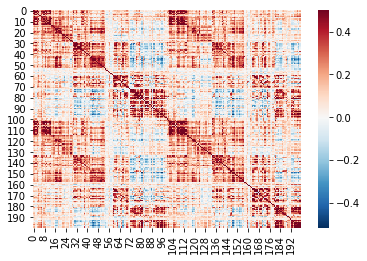

In [39]:
sns.heatmap(all_subs_emp_fc_mat[4], cmap='RdBu_r',center=0,vmax=0.5)

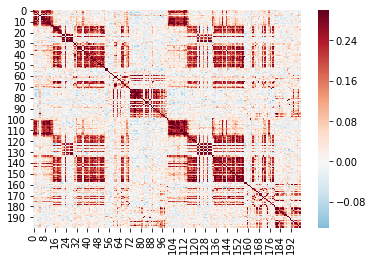

In [40]:
sns.heatmap(all_subs_og_whobpyt[4], cmap='RdBu_r',center=0,vmax=0.3)

In [41]:
corrs_list = []
for i in range(200):
    corrs_list.append(np.corrcoef(all_subs_emp_fc_mat[i][mask], all_subs_og_whobpyt[i][mask])[0][1])

In [42]:
# corrs_list

In [43]:
ntwx_labels_idxs = [
[0,14,100,115],
[14,30,115,134],
[30,43,134,147],
[43,54,147,158],
[54,60,158,164],
[60,73,164,181],
[73,100,181,200]]

In [44]:
Ntwx_labels = ['Vis', 'SomMot', 'DorsAttn', 'VentAttn', 'Limbic', 'FPN', 'DMN']

###  get the distance mtx

In [45]:
# from Davide's OHBM 2023 educational course google colab: 
# https://colab.research.google.com/drive/10irtJ_htqaicwL5r3DJOxu1vfQpAyYbK#scrollTo=AYDc8nuQAIjq

In [46]:
url = 'https://raw.githubusercontent.com/ThomasYeoLab/CBIG/master/stable_projects/brain_parcellation/Schaefer2018_LocalGlobal/Parcellations/MNI/Centroid_coordinates/Schaefer2018_200Parcels_7Networks_order_FSLMNI152_2mm.Centroid_RAS.csv'
atlas = pd.read_csv(url)
label = atlas['ROI Name']

label_stripped = []

for xx in range(len(label)):
    label_stripped.append(label[xx].replace('7Networks_',''))


coords = np.array([atlas['R'], atlas['A'], atlas['S']]).T
conduction_velocity = 5 #in ms

distance = np.zeros((coords.shape[0], coords.shape[0]))

for roi1 in range(coords.shape[0]):
    for roi2 in range(coords.shape[0]):
        distance[roi1, roi2] = np.sqrt(np.sum((coords[roi1,:] - coords[roi2,:])**2, axis=0))
        distance[roi1, roi2] = np.sqrt(np.sum((coords[roi1,:] - coords[roi2,:])**2, axis=0))




--> `distance` is distance mtx

In [47]:
coords.shape

(200, 3)

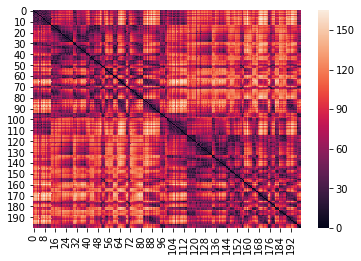

In [48]:
sns.heatmap(distance)

### plot Connectome
### (from `nilearn`)

In [49]:
from nilearn.plotting import view_connectome


In [50]:
from nilearn.plotting import plot_connectome


In [52]:
# %%time
# # Create a 3D plot of the connectome
# view_connectome(all_subs_pre_lap_SC[0], node_coords=coords, node_color='b', linewidth=1.0, node_size=5.0)



In [53]:
# colors = ['#781286','#4682B4','#00760E','#C43AFA','#DCF8A4','#E69422','#0C30F9','#CD3E4E']
colors = ['#781286','#4682B4','#00760E','#C43AFA','#DCF8A4','#E69422','#CD3E4E']


In [54]:
ntwx_labels_idxs = [
[0,14,100,115],
[14,30,115,134],
[30,43,134,147],
[43,54,147,158],
[54,60,158,164],
[60,73,164,181],
[73,100,181,200]]

In [55]:
# colors_list = ['' for _ in range(200)]
# dummy_list = ['' for _ in range(200)]

In [56]:
colors_list = ['' for _ in range(200)]
dummy_list = ['' for _ in range(200)]
for i in range(7):
    a, b, c, d = ntwx_labels_idxs[i]

    colors_list[a:b] = [colors[i]]*len(dummy_list[a:b])
    colors_list[c:d] = [colors[i]]*len(dummy_list[c:d])

In [57]:
%%time
# Create a 3D plot of the connectome
view_connectome(all_subs_pre_lap_SC[0], node_coords=coords, node_color=colors_list, linewidth=0.01, node_size=7.0)



CPU times: user 62.9 ms, sys: 9.1 ms, total: 72 ms
Wall time: 198 ms


In [58]:
def structurally_isolate_func_ntwx(a,b,c,d, sc):
    
    modified_matrix = sc.copy()

    modified_matrix[a:b,0:a] = 0
    modified_matrix[a:b,b:c] = 0
    modified_matrix[a:b,d:200] = 0
    modified_matrix[c:d,0:a] = 0
    modified_matrix[c:d,b:c] = 0
    modified_matrix[c:d,d:200] = 0

    modified_matrix[0:a,a:b] = 0
    modified_matrix[b:c,a:b] = 0
    modified_matrix[d:200,a:b] = 0
    modified_matrix[0:a,c:d] = 0
    modified_matrix[b:c,c:d] = 0
    modified_matrix[d:200,c:d] = 0
    
#     modified_matrix = modified_matrix/np.linalg.norm(modified_matrix)
    
    return modified_matrix

In [59]:
%%time
all_subs_sc_vis_lesion = []
all_subs_sc_smt_lesion = []
all_subs_sc_dan_lesion = []
all_subs_sc_van_lesion = []
all_subs_sc_lim_lesion = []
all_subs_sc_fpn_lesion = []
all_subs_sc_dmn_lesion = []

for i in range(200):
    sub_sc = all_subs_pre_lap_SC[i]
    
    vis_lesion_sc = structurally_isolate_func_ntwx(0,14,100,115, sub_sc)
    all_subs_sc_vis_lesion.append(vis_lesion_sc)
    del vis_lesion_sc
    
    smt_lesion_sc = structurally_isolate_func_ntwx(14,30,115,134, sub_sc)
    all_subs_sc_smt_lesion.append(smt_lesion_sc)
    del smt_lesion_sc
    
    dan_lesion_sc = structurally_isolate_func_ntwx(30,43,134,147, sub_sc)
    all_subs_sc_dan_lesion.append(dan_lesion_sc)
    del dan_lesion_sc
    
    van_lesion_sc = structurally_isolate_func_ntwx(43,54,147,158, sub_sc)
    all_subs_sc_van_lesion.append(van_lesion_sc)
    del van_lesion_sc
    
    lim_lesion_sc = structurally_isolate_func_ntwx(54,60,158,164, sub_sc)
    all_subs_sc_lim_lesion.append(lim_lesion_sc)
    del lim_lesion_sc
    
    fpn_lesion_sc = structurally_isolate_func_ntwx(60,73,164,181, sub_sc)
    all_subs_sc_fpn_lesion.append(fpn_lesion_sc)
    del fpn_lesion_sc
    
    dmn_lesion_sc = structurally_isolate_func_ntwx(73,100,181,200, sub_sc)
    all_subs_sc_dmn_lesion.append(dmn_lesion_sc)
    del dmn_lesion_sc

CPU times: user 112 ms, sys: 224 ms, total: 336 ms
Wall time: 334 ms


## Shortest Distance
### Using `networkx`

###  Basics ...

### Symmetric toy matrix

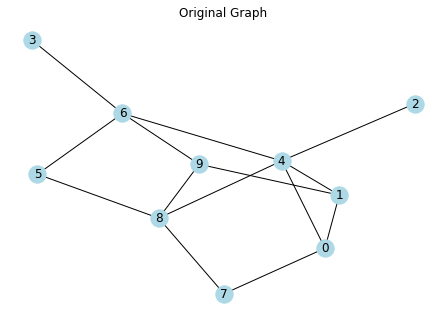

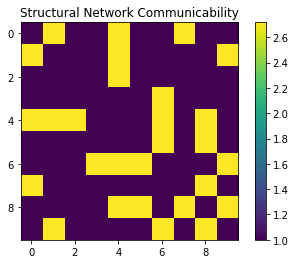

In [61]:
# Create a random graph (you can replace this with your own graph)
G = nx.erdos_renyi_graph(10, 0.3)

# Calculate the adjacency matrix
adj_matrix = nx.to_numpy_array(G)

# Calculate the matrix exponential of the adjacency matrix
communicability_matrix = np.exp(adj_matrix)

# Visualize the original graph
pos = nx.spring_layout(G, seed=13)
nx.draw(G, pos, with_labels=True, node_color='lightblue')
plt.title("Original Graph")
plt.show()

# Visualize the communicability matrix
plt.imshow(communicability_matrix, cmap='viridis', origin='upper')
plt.colorbar()
plt.title("Structural Network Communicability")
plt.show()

### Asymmetric Toy Matrix

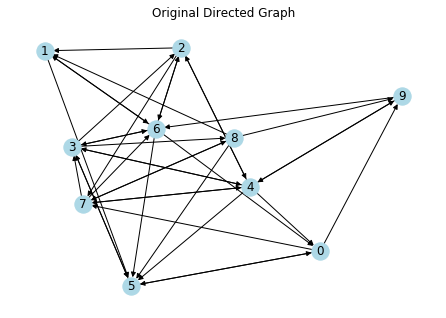

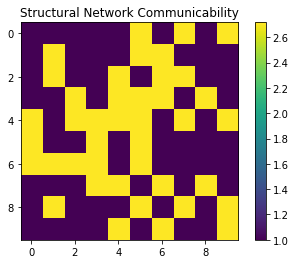

In [62]:
# Replace this with your 10x10 directed connectivity matrix
# Example matrix with random values:
connectivity_matrix = np.random.randint(0, 2, size=(10, 10))

# Calculate the matrix exponential of the directed connectivity matrix
communicability_matrix = np.exp(connectivity_matrix)

# Create a NetworkX directed graph from the connectivity matrix
G = nx.DiGraph(connectivity_matrix)

# Visualize the original directed graph
pos = nx.spring_layout(G, seed=42)
nx.draw(G, pos, with_labels=True, node_color='lightblue')
plt.title("Original Directed Graph")
plt.show()

# Visualize the communicability matrix
plt.imshow(communicability_matrix, cmap='viridis', origin='upper')
plt.colorbar()
plt.title("Structural Network Communicability")
plt.show()

# =============================================================

### Getting into it ...

In [63]:
D = all_subs_pre_lap_SC[34] # <-- some random subjects SC matrix

In [64]:
D.shape

(200, 200)

### intra hemisphere 

## 1)

In [65]:
G = nx.Graph(1/D)

# Choose source and target nodes
source_node = 15
target_node = 87

# Find shortest path using Dijkstra's algorithm
shortest_path = nx.shortest_path(G, source=source_node, target=target_node, weight='weight')

print(shortest_path, '\n')

for i in range(len(shortest_path)):
    print(labels[shortest_path[i]])


print('\n')
print('Total Hops = ', len(shortest_path)-1)

[15, 49, 94, 90, 88, 87] 

7Networks_LH_SomMot_2
7Networks_LH_SalVentAttn_FrOperIns_4
7Networks_LH_Default_PFC_13
7Networks_LH_Default_PFC_9
7Networks_LH_Default_PFC_7
7Networks_LH_Default_PFC_6


Total Hops =  5


### Observations ...

#### We can see in the previous example, that the source is in the left SMT (15) and the target is in the left DMN (87). The shortest path traverses through the left VAN. 

#### What happens if we eliminate this "in-between" network?


In [66]:
G = nx.Graph(1/all_subs_sc_van_lesion[34])

# Choose source and target nodes
source_node = 15
target_node = 87

# Find shortest path using Dijkstra's algorithm
shortest_path = nx.shortest_path(G, source=source_node, target=target_node, weight='weight')

print(shortest_path, '\n')

for i in range(len(shortest_path)):
    print(labels[shortest_path[i]])


print('\n')
print('Total Hops = ', len(shortest_path)-1)

[15, 16, 17, 19, 20, 69, 92, 93, 90, 88, 87] 

7Networks_LH_SomMot_2
7Networks_LH_SomMot_3
7Networks_LH_SomMot_4
7Networks_LH_SomMot_6
7Networks_LH_SomMot_7
7Networks_LH_Cont_PFCl_5
7Networks_LH_Default_PFC_11
7Networks_LH_Default_PFC_12
7Networks_LH_Default_PFC_9
7Networks_LH_Default_PFC_7
7Networks_LH_Default_PFC_6


Total Hops =  10


## 2)

In [67]:
G = nx.Graph(1/D)

# Choose source and target nodes
source_node = 135
target_node = 197

# Find shortest path using Dijkstra's algorithm
shortest_path = nx.shortest_path(G, source=source_node, target=target_node, weight='weight')

print(shortest_path, '\n')

for i in range(len(shortest_path)):
    print(labels[shortest_path[i]])


print('\n')
print('Total Hops = ', len(shortest_path)-1)

[135, 104, 110, 139, 176, 197] 

7Networks_RH_DorsAttn_Post_2
7Networks_RH_Vis_5
7Networks_RH_Vis_11
7Networks_RH_DorsAttn_Post_6
7Networks_RH_Cont_pCun_1
7Networks_RH_Default_pCunPCC_1


Total Hops =  5


### Observations ...

#### We can see in the previous example, that the source is in the right DAN (135) and the target is in the right DMN (197). The shortest path traverses through the right VIS and right FPN. 

#### What happens if we eliminate one of these "in-between" network?


In [68]:
G = nx.Graph(1/all_subs_sc_vis_lesion[34])

# Choose source and target nodes
source_node = 135
target_node = 197

# Find shortest path using Dijkstra's algorithm
shortest_path = nx.shortest_path(G, source=source_node, target=target_node, weight='weight')

print(shortest_path, '\n')

for i in range(len(shortest_path)):
    print(labels[shortest_path[i]])


print('\n')
print('Total Hops = ', len(shortest_path)-1)

[135, 181, 141, 139, 176, 197] 

7Networks_RH_DorsAttn_Post_2
7Networks_RH_Default_Par_1
7Networks_RH_DorsAttn_Post_8
7Networks_RH_DorsAttn_Post_6
7Networks_RH_Cont_pCun_1
7Networks_RH_Default_pCunPCC_1


Total Hops =  5


##  ------

In [69]:
G = nx.Graph(1/all_subs_sc_fpn_lesion[34])

# Choose source and target nodes
source_node = 135
target_node = 197

# Find shortest path using Dijkstra's algorithm
shortest_path = nx.shortest_path(G, source=source_node, target=target_node, weight='weight')

print(shortest_path, '\n')

for i in range(len(shortest_path)):
    print(labels[shortest_path[i]])


print('\n')
print('Total Hops = ', len(shortest_path)-1)

[135, 104, 111, 108, 103, 106, 197] 

7Networks_RH_DorsAttn_Post_2
7Networks_RH_Vis_5
7Networks_RH_Vis_12
7Networks_RH_Vis_9
7Networks_RH_Vis_4
7Networks_RH_Vis_7
7Networks_RH_Default_pCunPCC_1


Total Hops =  6


### cross hemisphere

In [70]:
G = nx.Graph(1/D)

# Choose source and target nodes
source_node = 64
target_node = 121

# Find shortest path using Dijkstra's algorithm
shortest_path = nx.shortest_path(G, source=source_node, target=target_node, weight='weight')

print(shortest_path, '\n')

for i in range(len(shortest_path)):
    print(labels[shortest_path[i]])


print('\n')
print('Total Hops = ', len(shortest_path)-1)

[64, 82, 85, 193, 194, 195, 175, 146, 121] 

7Networks_LH_Cont_OFC_1
7Networks_LH_Default_PFC_1
7Networks_LH_Default_PFC_4
7Networks_RH_Default_PFCdPFCm_4
7Networks_RH_Default_PFCdPFCm_5
7Networks_RH_Default_PFCdPFCm_6
7Networks_RH_Cont_PFCl_7
7Networks_RH_DorsAttn_PrCv_1
7Networks_RH_SomMot_7


Total Hops =  8


### Observations ...

#### We can see in the previous example, that the source is in the left FPN (64) and the target is in the right SMT (121). The shortest path traverses through the left and right DMN and right DAN. 

#### What happens if we eliminate one of these "in-between" networks?


In [71]:
G = nx.Graph(1/all_subs_sc_dmn_lesion[34])

# Choose source and target nodes
source_node = 64
target_node = 121

# Find shortest path using Dijkstra's algorithm
shortest_path = nx.shortest_path(G, source=source_node, target=target_node, weight='weight')

print(shortest_path, '\n')

for i in range(len(shortest_path)):
    print(labels[shortest_path[i]])


print('\n')
print('Total Hops = ', len(shortest_path)-1)

[64, 55, 160, 170, 171, 172, 146, 121] 

7Networks_LH_Cont_OFC_1
7Networks_LH_Limbic_OFC_2
7Networks_RH_Limbic_OFC_3
7Networks_RH_Cont_PFCl_2
7Networks_RH_Cont_PFCl_3
7Networks_RH_Cont_PFCl_4
7Networks_RH_DorsAttn_PrCv_1
7Networks_RH_SomMot_7


Total Hops =  7


# --------------------------------------------------------------------------------------------------

### Check the distance between hops along the shortest path. 

In [77]:
D = all_subs_pre_lap_SC[34]

#### intra hemisphere

In [78]:
G = nx.Graph(1 / D)

source_node = 15
target_node = 87

# Find shortest path lengths using Dijkstra's algorithm
shortest_path_length = nx.shortest_path_length(G, source=source_node, target=target_node, weight='weight')

print("Shortest path length:", shortest_path_length)

# Find the shortest path itself
shortest_path = nx.shortest_path(G, source=source_node, target=target_node, weight='weight')

print("Shortest path:", shortest_path)

print('\n')

for i in range(len(shortest_path)):
    print(labels[shortest_path[i]])


print('\n')
print('Total Hops = ', len(shortest_path)-1)
print('\n')
# Calculate distance between each hop
total_distance = 0
for i in range(len(shortest_path) - 1):
    distance = G[shortest_path[i]][shortest_path[i+1]]['weight']
    total_distance += distance
#     print(f"Distance from {labels[shortest_path[i]]} to {labels[shortest_path[i+1]]}: {distance}")

# print("Total distance traveled:", total_distance)

Shortest path length: 0.0029841471349984806
Shortest path: [15, 49, 94, 90, 88, 87]


7Networks_LH_SomMot_2
7Networks_LH_SalVentAttn_FrOperIns_4
7Networks_LH_Default_PFC_13
7Networks_LH_Default_PFC_9
7Networks_LH_Default_PFC_7
7Networks_LH_Default_PFC_6


Total Hops =  5




#### VAN lesion

In [79]:
G = nx.Graph(1 / all_subs_sc_van_lesion[34])

# Find shortest path lengths using Dijkstra's algorithm
shortest_path_length = nx.shortest_path_length(G, source=source_node, target=target_node, weight='weight')

print("Shortest path length:", shortest_path_length)

# Find the shortest path itself
shortest_path = nx.shortest_path(G, source=source_node, target=target_node, weight='weight')

print("Shortest path:", shortest_path)

print('\n')

for i in range(len(shortest_path)):
    print(labels[shortest_path[i]])


print('\n')
print('Total Hops = ', len(shortest_path)-1)
print('\n')
# Calculate distance between each hop
total_distance = 0
for i in range(len(shortest_path) - 1):
    distance = G[shortest_path[i]][shortest_path[i+1]]['weight']
    total_distance += distance
#     print(f"Distance from {labels[shortest_path[i]]} to {labels[shortest_path[i+1]]}: {distance}")

# print("Total distance traveled:", total_distance)

Shortest path length: 0.0030758179188739875
Shortest path: [15, 16, 17, 19, 20, 69, 92, 93, 90, 88, 87]


7Networks_LH_SomMot_2
7Networks_LH_SomMot_3
7Networks_LH_SomMot_4
7Networks_LH_SomMot_6
7Networks_LH_SomMot_7
7Networks_LH_Cont_PFCl_5
7Networks_LH_Default_PFC_11
7Networks_LH_Default_PFC_12
7Networks_LH_Default_PFC_9
7Networks_LH_Default_PFC_7
7Networks_LH_Default_PFC_6


Total Hops =  10




#### cross hemisphere

In [80]:
G = nx.Graph(1 / D)

source_node = 64
target_node = 121

# Find shortest path lengths using Dijkstra's algorithm
shortest_path_length = nx.shortest_path_length(G, source=source_node, target=target_node, weight='weight')

print("Shortest path length:", shortest_path_length)

# Find the shortest path itself
shortest_path = nx.shortest_path(G, source=source_node, target=target_node, weight='weight')

print("Shortest path:", shortest_path)

print('\n')

for i in range(len(shortest_path)):
    print(labels[shortest_path[i]])


print('\n')
print('Total Hops = ', len(shortest_path)-1)
print('\n')
# Calculate distance between each hop
total_distance = 0
for i in range(len(shortest_path) - 1):
    distance = G[shortest_path[i]][shortest_path[i+1]]['weight']
    total_distance += distance
#     print(f"Distance from {labels[shortest_path[i]]} to {labels[shortest_path[i+1]]}: {distance}")

# print("Total distance traveled:", total_distance)

Shortest path length: 0.0030621217220450185
Shortest path: [64, 82, 85, 193, 194, 195, 175, 146, 121]


7Networks_LH_Cont_OFC_1
7Networks_LH_Default_PFC_1
7Networks_LH_Default_PFC_4
7Networks_RH_Default_PFCdPFCm_4
7Networks_RH_Default_PFCdPFCm_5
7Networks_RH_Default_PFCdPFCm_6
7Networks_RH_Cont_PFCl_7
7Networks_RH_DorsAttn_PrCv_1
7Networks_RH_SomMot_7


Total Hops =  8




#### DMN lesion

In [81]:
G = nx.Graph(1 / all_subs_sc_dmn_lesion[34])

source_node = 64
target_node = 121

# Find shortest path lengths using Dijkstra's algorithm
shortest_path_length = nx.shortest_path_length(G, source=source_node, target=target_node, weight='weight')

print("Shortest path length:", shortest_path_length)

# Find the shortest path itself
shortest_path = nx.shortest_path(G, source=source_node, target=target_node, weight='weight')

print("Shortest path:", shortest_path)

print('\n')

for i in range(len(shortest_path)):
    print(labels[shortest_path[i]])


print('\n')
print('Total Hops = ', len(shortest_path)-1)
print('\n')
# Calculate distance between each hop
total_distance = 0
for i in range(len(shortest_path) - 1):
    distance = G[shortest_path[i]][shortest_path[i+1]]['weight']
    total_distance += distance
#     print(f"Distance from {labels[shortest_path[i]]} to {labels[shortest_path[i+1]]}: {distance}")

# print("Total distance traveled:", total_distance)

Shortest path length: 0.004882894407741126
Shortest path: [64, 55, 160, 170, 171, 172, 146, 121]


7Networks_LH_Cont_OFC_1
7Networks_LH_Limbic_OFC_2
7Networks_RH_Limbic_OFC_3
7Networks_RH_Cont_PFCl_2
7Networks_RH_Cont_PFCl_3
7Networks_RH_Cont_PFCl_4
7Networks_RH_DorsAttn_PrCv_1
7Networks_RH_SomMot_7


Total Hops =  7




In [82]:
%%time

D = all_subs_pre_lap_SC[34]
G = nx.Graph(1/D)

i = 13
j = 14

shortest_path_labels = []
# Choose source and target nodes
source_node = i
target_node = j

shortest_path_length = nx.shortest_path_length(G, source=source_node, target=target_node, weight='weight')

# Find shortest path using Dijkstra's algorithm
shortest_path = nx.shortest_path(G, source=source_node, target=target_node, weight='weight')

for q in range(len(shortest_path)):
    shortest_path_labels.append(labels[shortest_path[q]])

# Example label list
example_labels = shortest_path_labels.copy()

# Extract unique network names from example_labels using regular expressions
network_names = set()
for label in example_labels:
    match = re.search(r'7Networks_(\w+)_\d+', label)
    if match:
        network_names.add(match.group(1))

# Determine the order of network names based on their appearance in the example labels
network_order = sorted(network_names, key=lambda x: example_labels.index(next(label for label in example_labels if f'7Networks_{x}_' in label)))

# Remove 'LH_' and 'RH_' from network names
refined_network_order = [re.sub(r'^(LH_|RH_)', '', network) for network in network_order]

# Remove underscore and anything that follows it from network names
final_network_order = [re.sub(r'_.*$', '', network) for network in refined_network_order]

# Eliminate duplicates
final_network_order_unique = list(set(final_network_order))
in_between_ntwx = final_network_order_unique.copy()

# Check source
source = None
target = None

for network in final_network_order_unique:
    for label in example_labels:
        if network in label:
            if label == example_labels[0]:
                source = network
                if network in in_between_ntwx:
                    in_between_ntwx.remove(network)
            elif label == example_labels[-1]:
                target = network
                if network in in_between_ntwx:
                    in_between_ntwx.remove(network)



print('source: ', source, '\n')
print('target: ', target, '\n')
print('in-between: ', in_between_ntwx, '\n')
print('shortest_path_length: ', shortest_path_length, '\n')
print('shortest_path: ', shortest_path, '\n')
print('number of hops: ', len(shortest_path)-1, '\n')
    

source:  Vis 

target:  SomMot 

in-between:  ['Default'] 

shortest_path_length:  0.001684427097955886 

shortest_path:  [13, 75, 15, 14] 

number of hops:  3 

CPU times: user 182 ms, sys: 2.8 ms, total: 185 ms
Wall time: 183 ms


In [83]:
# Initialize the linewidth list with the default value for all edges
num_edges = len(coords) * (len(coords) - 1) // 2  # Number of edges in a fully connected graph
linewidths = [0.01] * num_edges

In [84]:
# Set a thicker linewidth for edges between consecutive nodes in the shortest path
for i in range(len(shortest_path) - 1):
    source_node = shortest_path[i]
    target_node = shortest_path[i + 1]
    edge_index = source_node * (len(coords) - 1) + target_node - (source_node + 1) * (source_node + 2) // 2
    linewidths[edge_index] = 0.1  # Set the desired thicker linewidth here

In [85]:
colors_list = ['' for _ in range(200)]

nodes_list = [5.0] * 200

linewidths = [0.01]*len(edge_list)

   
colors_list[0:200] = ['k']*200
for index in shortest_path:
    colors_list[index] = 'r'
    nodes_list[index] = 10.0

NameError: name 'edge_list' is not defined

In [349]:
%%time
# Create a 3D plot of the connectome
view_connectome(all_subs_pre_lap_SC[34], node_coords=coords, node_color=colors_list, linewidth=0.05, node_size=nodes_list)



CPU times: user 62.5 ms, sys: 3.99 ms, total: 66.5 ms
Wall time: 85.2 ms


In [86]:
%%time

D = all_subs_sc_dmn_lesion[34]
G = nx.Graph(1/D)

i = 13
j = 14

shortest_path_labels = []
# Choose source and target nodes
source_node = i
target_node = j

shortest_path_length = nx.shortest_path_length(G, source=source_node, target=target_node, weight='weight')

# Find shortest path using Dijkstra's algorithm
shortest_path = nx.shortest_path(G, source=source_node, target=target_node, weight='weight')

for q in range(len(shortest_path)):
    shortest_path_labels.append(labels[shortest_path[q]])

# Example label list
example_labels = shortest_path_labels.copy()

# Extract unique network names from example_labels using regular expressions
network_names = set()
for label in example_labels:
    match = re.search(r'7Networks_(\w+)_\d+', label)
    if match:
        network_names.add(match.group(1))

# Determine the order of network names based on their appearance in the example labels
network_order = sorted(network_names, key=lambda x: example_labels.index(next(label for label in example_labels if f'7Networks_{x}_' in label)))

# Remove 'LH_' and 'RH_' from network names
refined_network_order = [re.sub(r'^(LH_|RH_)', '', network) for network in network_order]

# Remove underscore and anything that follows it from network names
final_network_order = [re.sub(r'_.*$', '', network) for network in refined_network_order]

# Eliminate duplicates
final_network_order_unique = list(set(final_network_order))
in_between_ntwx = final_network_order_unique.copy()

# Check source
source = None
target = None

for network in final_network_order_unique:
    for label in example_labels:
        if network in label:
            if label == example_labels[0]:
                source = network
                if network in in_between_ntwx:
                    in_between_ntwx.remove(network)
            elif label == example_labels[-1]:
                target = network
                if network in in_between_ntwx:
                    in_between_ntwx.remove(network)



print('source: ', source, '\n')
print('target: ', target, '\n')
print('in-between: ', in_between_ntwx, '\n')
print('shortest_path_length: ', shortest_path_length, '\n')
print('shortest_path: ', shortest_path, '\n')
print('number of hops: ', len(shortest_path)-1, '\n')
    

source:  Vis 

target:  SomMot 

in-between:  ['DorsAttn'] 

shortest_path_length:  0.002504696980143409 

shortest_path:  [13, 36, 14] 

number of hops:  2 

CPU times: user 174 ms, sys: 4.99 ms, total: 179 ms
Wall time: 177 ms


In [35]:
%%time
# Create a 3D plot of the connectome
view_connectome(all_subs_pre_lap_SC[0], node_coords=coords, node_color='k', linewidth=3.0, node_size=10.0)



CPU times: user 71.5 ms, sys: 24.2 ms, total: 95.7 ms
Wall time: 330 ms


In [87]:
colors_list = ['' for _ in range(200)]


for i in range(7):
    
    colors_list[0:200] = ['k']*200
    for index in shortest_path:
        colors_list[index] = 'r'

In [88]:
%%time
# Create a 3D plot of the connectome
view_connectome(all_subs_pre_lap_SC[34], node_coords=coords, node_color=colors_list, linewidth=0.01, node_size=10.0)



CPU times: user 65.5 ms, sys: 12.3 ms, total: 77.7 ms
Wall time: 122 ms


# --------------------------------------------------------------------------------------------------------------

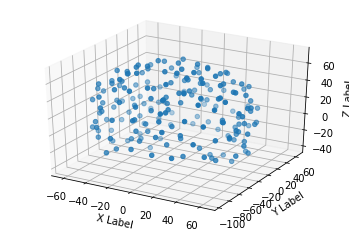

In [89]:
# Assuming 'coordinates' is your [200, 3] list of coordinates
coordinates = coords.copy()  # Your data here

# Create a 3D plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Extract x, y, z coordinates
x = coordinates[:, 0]
y = coordinates[:, 1]
z = coordinates[:, 2]

# Create scatter plot
ax.scatter(x, y, z)

# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

# Show the plot
plt.show()

In [90]:
import plotly.express as px


In [91]:
# Create a scatter plot
fig = px.scatter_3d(x=coordinates[:, 0], y=coordinates[:, 1], z=coordinates[:, 2])

# Show the interactive plot
fig.show()

In [112]:
import plotly.express as px
import plotly.graph_objects as go

# Assuming 'coordinates' is your [200, 3] list of coordinates
coordinates = coords.copy()  # Your data here
specific_indices = [64, 82, 85, 193, 194, 195, 175, 146, 121]
specific_indices_lesion = [64, 55, 160, 170, 171, 172, 146, 121]
# Convert the 'coordinates' list to a NumPy array
coordinates = np.array(coordinates)

# Create separate arrays for specific and non-specific coordinates
specific_coords = coordinates[specific_indices]
other_indices = np.setdiff1d(np.arange(len(coordinates)), specific_indices)
other_coords = coordinates[other_indices]

# Create scatter plot for specific coordinates (red)
fig = go.Figure(data=[
    go.Scatter3d(
        x=specific_coords[:, 0],
        y=specific_coords[:, 1],
        z=specific_coords[:, 2],
        mode='markers',
        marker=dict(color='red', opacity=0.9,size=5),
        name='Shortest path coords'
    ),
    go.Scatter3d(
        x=other_coords[:, 0],
        y=other_coords[:, 1],
        z=other_coords[:, 2],
        mode='markers',
        marker=dict(color='grey', opacity=0.9,size=3),
        name='-'
    ),
    go.Scatter3d(
        x=specific_coords[:, 0],
        y=specific_coords[:, 1],
        z=specific_coords[:, 2],
        mode='lines',
        line=dict(color='red', width=2),
        name='Shortest Path'
    )
])

# Set the layout
fig.update_layout(scene=dict(aspectmode='data'), title='3D Scatter Plot')

# Show the interactive plot
fig.show()

In [110]:
shortest_path = [64, 82, 85, 193, 194, 195, 175, 146, 121] 

In [111]:
shortest_path_lesion = [64, 55, 160, 170, 171, 172, 146, 121]

In [ ]:
for i in range(len(shortest_path)-1):
    print(all_subs_pre_lap_SC[])

In [115]:
specific_indices = [64, 55, 160, 170, 171, 172, 146, 121]
specific_indices_lesion = [64, 82, 85, 193, 194, 195, 175, 146, 121]

coordinates = coords.copy()
# Convert the 'coordinates' list to a NumPy array
coordinates = np.array(coordinates)

# Create separate arrays for specific and non-specific coordinates
specific_coords = coordinates[specific_indices]
specific_coords_lesion = coordinates[specific_indices_lesion]
other_indices = np.setdiff1d(np.arange(len(coordinates)), np.concatenate((specific_indices, specific_indices_lesion)))
other_coords = coordinates[other_indices]

# Create scatter plot for specific coordinates (red)
fig = go.Figure(data=[
    go.Scatter3d(
        x=specific_coords[:, 0],
        y=specific_coords[:, 1],
        z=specific_coords[:, 2],
        mode='markers',
        marker=dict(color='red', opacity=0.7),
        name='Specific Coords'
    ),
#     go.Scatter3d(
#         x=specific_coords_lesion[:, 0],
#         y=specific_coords_lesion[:, 1],
#         z=specific_coords_lesion[:, 2],
#         mode='markers',
#         marker=dict(color='blue', opacity=0.7),
#         name='Specific Coords Lesion'
#     ),
    go.Scatter3d(
        x=other_coords[:, 0],
        y=other_coords[:, 1],
        z=other_coords[:, 2],
        mode='markers',
        marker=dict(color='grey', opacity=0.9, size=3),
        name='Other Coords'
    ),
    go.Scatter3d(
        x=specific_coords[:, 0],
        y=specific_coords[:, 1],
        z=specific_coords[:, 2],
        mode='lines',
        line=dict(color='red', width=2),
        name='Connection Line'
    )#,
#     go.Scatter3d(
#         x=specific_coords_lesion[:, 0],
#         y=specific_coords_lesion[:, 1],
#         z=specific_coords_lesion[:, 2],
#         mode='lines',
#         line=dict(color='black', width=2),
#         name='Connection Line Lesion'
#     )
])

# Set the layout
fig.update_layout(scene=dict(aspectmode='data'), title='3D Scatter Plot')

# Show the interactive plot
fig.show()

In [120]:
# import plotly.express as px
# import plotly.graph_objects as go

# Assuming 'coordinates' is your [200, 3] list of coordinates
coordinates = coords.copy()  # Your data here
specific_indices = [64, 82, 85, 193, 194, 195, 175, 146, 121]
specific_indices_lesion = [64, 55, 160, 170, 171, 172, 146, 121]
# Convert the 'coordinates' list to a NumPy array
coordinates = np.array(coordinates)

# Create separate arrays for specific and non-specific coordinates
specific_coords = coordinates[specific_indices]

specific_coords_lesion = coordinates[specific_indices_lesion]

# other_indices = np.setdiff1d(np.arange(len(coordinates)), specific_indices)
other_indices = np.setdiff1d(np.arange(len(coordinates)), np.concatenate((specific_indices, specific_indices_lesion)))

other_coords = coordinates[other_indices]

# Create scatter plot for specific coordinates (red)
fig = go.Figure(data=[
    go.Scatter3d(
        x=specific_coords[:, 0],
        y=specific_coords[:, 1],
        z=specific_coords[:, 2],
        mode='markers',
        marker=dict(color='red', opacity=0.9,size=5),
        name='Shortest path coords'
    ),
    
    go.Scatter3d(
        x=specific_coords_lesion[:, 0],
        y=specific_coords_lesion[:, 1],
        z=specific_coords_lesion[:, 2],
        mode='markers',
        marker=dict(color='blue', opacity=0.9,size=5),
        name='Shortest path lesion coords'
    ),
    
    go.Scatter3d(
        x=other_coords[:, 0],
        y=other_coords[:, 1],
        z=other_coords[:, 2],
        mode='markers',
        marker=dict(color='grey', opacity=0.9,size=3),
        name='-'
    ),
    go.Scatter3d(
        x=specific_coords[:, 0],
        y=specific_coords[:, 1],
        z=specific_coords[:, 2],
        mode='lines',
        line=dict(color='red', width=2),
        name='Shortest Path'
    ),
    go.Scatter3d(
        x=specific_coords_lesion[:, 0],
        y=specific_coords_lesion[:, 1],
        z=specific_coords_lesion[:, 2],
        mode='lines',
        line=dict(color='blue', width=2),
        name='Shortest lesion Path'
    )
])

# Set the layout
fig.update_layout(scene=dict(aspectmode='data'), title='3D Scatter Plot')

# Show the interactive plot
fig.show()

In [122]:
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation

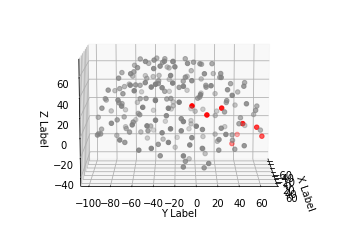

In [126]:
# Create a figure and 3D axis
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Convert the 'coordinates' list to a NumPy array
coordinates = np.array(coordinates)

# Specific and non-specific indices
specific_indices = [64, 55, 160, 170, 171, 172, 146, 121]
other_indices = np.setdiff1d(np.arange(len(coordinates)), specific_indices)

# Separate specific and other coordinates
specific_coords = coordinates[specific_indices]
other_coords = coordinates[other_indices]

# Scatter plot for specific coordinates (red)
ax.scatter(specific_coords[:, 0], specific_coords[:, 1], specific_coords[:, 2], c='red', label='Specific Coords')

# Scatter plot for other coordinates (grey)
ax.scatter(other_coords[:, 0], other_coords[:, 1], other_coords[:, 2], c='grey', label='Other Coords')

# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

# Create a function to update the plot for each frame
def update_rotation(num, ax, fig):
    ax.view_init(elev=10, azim=num)

# Create the animation
animation = FuncAnimation(fig, update_rotation, frames=np.arange(0, 360, 2), fargs=(ax, fig))

# Save the animation as a GIF
animation.save('rotation.gif', writer='imagemagick', fps=30)

plt.show()